In [1]:
import velvet as vt

# general packages
import numpy as np
import pandas as pd
import torch
from scipy.sparse import issparse

# velocity packages
import scanpy as sc
import scvelo as scv
import anndata as ann

# plotting packages
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm, trange
from IPython.display import clear_output

# color palette object
from colors import colorpalette as colpal

2023-06-04 15:25:14.456732: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-04 15:25:24.183586: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /camp/apps/eb/software/CUDAcore/11.1.1/nvvm/lib64:/camp/apps/eb/software/CUDAcore/11.1.1/extras/CUPTI/lib64:/camp/apps/eb/software/CUDAcore/11.1.1/lib:/camp/apps/eb/software/binutils/2.35-GCCcore-10.2.0/lib:/camp/apps/eb/software/zlib/1.2.11-GCCcore-10.2.0/lib:/camp/apps/eb/software/GCCcore/10.2.0/lib64:/camp/apps/eb/software/GCCcore/10.2.0/lib
2023-06-04 15:25:24.183875: W tensorflow/compi

In [2]:
import dynamo as dyn
import matplotlib
matplotlib.rcParams.update(matplotlib.rcParamsDefault)

|-----> setting visualization default mode in dynamo. Your customized matplotlib settings might be overritten.


In [3]:
ann.__version__

'0.8.0'

In [4]:
adata0 = vt.pp.read("../data/celltyped_adata.h5ad")
adata0 = adata0[adata0.obs.cell_annotation!='other']

adata0

View of AnnData object with n_obs × n_vars = 44713 × 24967
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'label_rate', 'doublet_score', 'marker_based_classification', 'cell_annotation'
    layers: 'new', 'old', 'total'

In [5]:
neural_types = ['Early_Neural','Neural','pMN','p3','FP','MN','V3']

neural = adata0[[ct in neural_types for ct in adata0.obs.cell_annotation]]

neural_genes = vt.pp.select_genes(
    neural[neural.obs.rep!='r4'], 
    n_variable_genes=3000, 
    stratify_obs='rep')

In [6]:
neural.obs['labelling_time'] = 2.0

dyn.pp.recipe_monocle(
    neural, 
    genes_to_use=neural_genes, 
    keep_filtered_genes=False,
    keep_filtered_cells=True,
    tkey='labelling_time'
)

dyn.tl.dynamics(neural)

|-----> recipe_monocle_keep_raw_layers_key is None. Using default value from DynamoAdataConfig: recipe_monocle_keep_raw_layers_key=True
|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----> 
Dynamo detects your labeling data is from a one-shot experiment. If experiment type is not corrent, please correct 
this via supplying the correct experiment_type (one of `one-shot`, `kin`, `deg`) as needed.
|-----> detected experiment type: one-shot
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|---

estimating gamma: 100%|██████████| 2000/2000 [13:53<00:00,  2.40it/s]


AnnData object with n_obs × n_vars = 26533 × 2000
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'label_rate', 'doublet_score', 'marker_based_classification', 'cell_annotation', 'labelling_time', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'total_Size_Factor', 'initial_total_cell_size', 'Size_Factor', 'initial_cell_size', 'new_Size_Factor', 'initial_new_cell_size', 'ntr'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'use_for_pca', 'frac', 'ntr', 'alpha', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'beta_k', 'gamma_k', 'use_for_dynamics'
    uns: 'pp', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'dynamics'
    obsm: 'X_pca', 'X'
    varm: 'alpha'
    layers

In [7]:
X = neural.layers['X_total'].A
V = neural.layers['velocity_T'].A

V = np.nan_to_num(V)
Y = np.clip(X + V, 0, 1000)

Xlog = np.log1p(X)
Xlogscale = Xlog - Xlog.mean(0)
pca = PCA()
Xpca = pca.fit_transform(Xlogscale)
neural.obsm['X_dynamo'] = Xpca

Ylogscale = np.log1p(Y) - Xlog.mean(0)
Ypca = pca.transform(Ylogscale)

neural.obsm['velocity_dynamo'] = Ypca - Xpca
neural.uns["velocity_params"] = {'embeddings':'dynamo'}


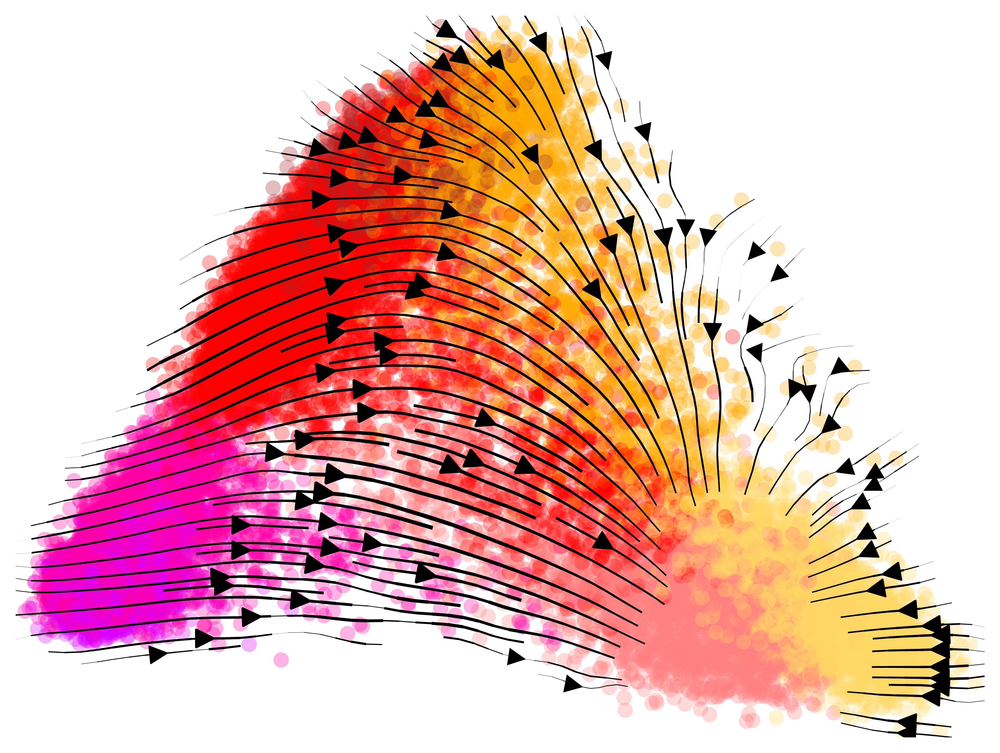

In [8]:
fig = plt.figure(figsize=(8,6), dpi=300)

ax = fig.subplots()

scv.pl.velocity_embedding_stream(
    neural, 
    basis='dynamo', 
    title="",
    color='cell_annotation', 
    show=False,
    ax=ax,
    palette=colpal.celltype,
    arrow_size=2,
    legend_loc=False,
    size=200,
    fontsize=16, 
    legend_fontsize=16, components='1,2'
)
plt.savefig('../figures/2.1.0_neural_dynamo.png', transparent=True)
plt.show()

### dynamo - nmp

In [9]:
nt_types = ['MN', 'V3', 'p3','FP']

nmp = adata0[[ct not in nt_types for ct in adata0.obs.cell_annotation]]
nmp = nmp[[tp not in ['D3','D6','D7','D8'] for tp in nmp.obs.timepoint]]

nmp_genes = vt.pp.select_genes(
    nmp[nmp.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

In [10]:
nmp.obs['labelling_time'] = 2.0

dyn.pp.recipe_monocle(
    nmp, 
    genes_to_use=nmp_genes, 
    keep_filtered_genes=False,
    keep_filtered_cells=True,
    tkey='labelling_time'
)

dyn.tl.dynamics(nmp)

|-----> recipe_monocle_keep_raw_layers_key is None. Using default value from DynamoAdataConfig: recipe_monocle_keep_raw_layers_key=True
|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----> 
Dynamo detects your labeling data is from a one-shot experiment. If experiment type is not corrent, please correct 
this via supplying the correct experiment_type (one of `one-shot`, `kin`, `deg`) as needed.
|-----> detected experiment type: one-shot
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|---

estimating gamma: 100%|██████████| 1218/1218 [05:41<00:00,  3.57it/s]


AnnData object with n_obs × n_vars = 24262 × 1218
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'label_rate', 'doublet_score', 'marker_based_classification', 'cell_annotation', 'labelling_time', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'total_Size_Factor', 'initial_total_cell_size', 'Size_Factor', 'initial_cell_size', 'new_Size_Factor', 'initial_new_cell_size', 'ntr'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'use_for_pca', 'frac', 'ntr', 'alpha', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'beta_k', 'gamma_k', 'use_for_dynamics'
    uns: 'pp', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'dynamics'
    obsm: 'X_pca', 'X'
    varm: 'alpha'
    layers

In [11]:
X = nmp.layers['X_total'].A
V = nmp.layers['velocity_T'].A

V = np.nan_to_num(V)
Y = np.clip(X + V, 0, 1000)

Xlog = np.log1p(X)
Xlogscale = Xlog - Xlog.mean(0)
pca = PCA()
Xpca = pca.fit_transform(Xlogscale)
nmp.obsm['X_dynamo'] = Xpca

Ylogscale = np.log1p(Y) - Xlog.mean(0)
Ypca = pca.transform(Ylogscale)

nmp.obsm['velocity_dynamo'] = Ypca - Xpca
nmp.uns["velocity_params"] = {'embeddings':'dynamo'}

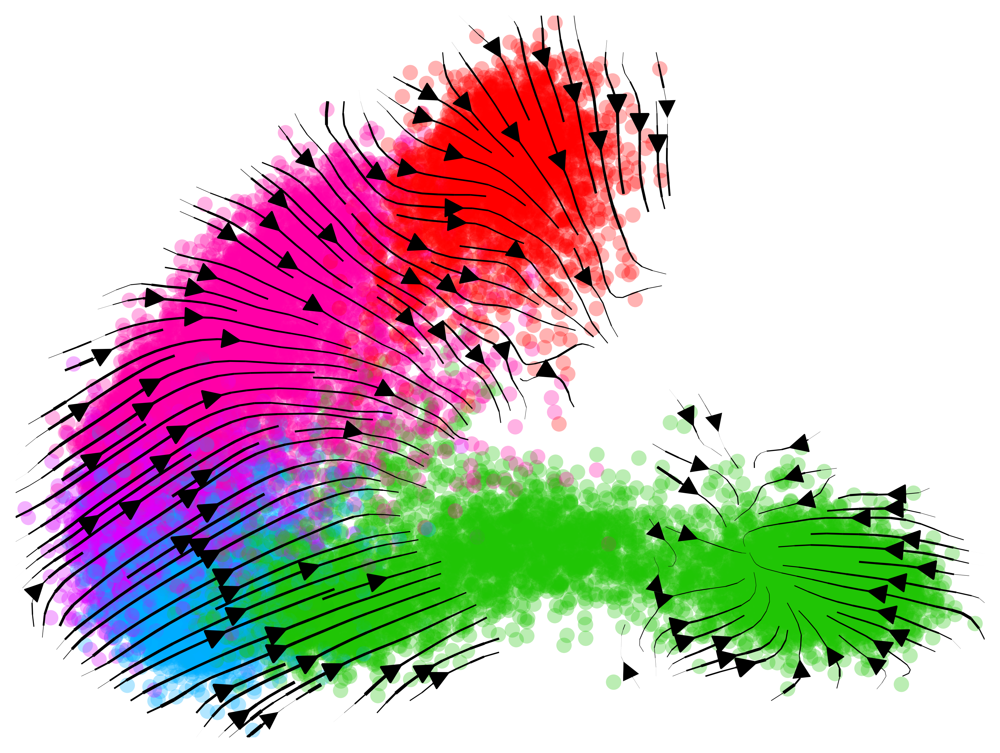

In [12]:
fig = plt.figure(figsize=(8,6), dpi=300)

ax = fig.subplots()

scv.pl.velocity_embedding_stream(
    nmp, 
    basis='dynamo', 
    title="",
    color='cell_annotation', 
    show=False,
    ax=ax,
    palette=colpal.celltype,
    arrow_size=2,
    legend_loc=False,
    size=200,
    fontsize=16, 
    legend_fontsize=16, components='1,2'
)
plt.savefig('../figures/2.1.1_nmp_dynamo.png', transparent=True)
plt.show()

# scvelo

In [13]:
adataS = vt.pp.read("../data/celltyped_adata_splicing.h5ad")
adataS = adataS[adataS.obs.cell_annotation!='other']

adataS

View of AnnData object with n_obs × n_vars = 44713 × 24967
    obs: 'X_TC_alpha', 'total_TC_alpha', 'unspliced_TC_alpha', 'spliced_TC_alpha', 'p_e', 'p_c_TC', 'sample', 'timepoint', 'rep', 'marker_based_classification', 'cell_annotation'
    layers: 'spliced', 'unspliced'

In [14]:
neural_types = ['Early_Neural','Neural','pMN','p3','FP','MN','V3']

sneural = adataS[[ct in neural_types for ct in adataS.obs.cell_annotation]]

sneural_genes = vt.pp.select_genes(
    sneural[sneural.obs.rep!='r4'], 
    n_variable_genes=3000, 
    stratify_obs='rep')

scv.pp.normalize_per_cell(sneural)
sneural = sneural[:,sneural_genes]

Normalized count data: X, spliced, unspliced.


In [15]:
scv.pp.moments(sneural, n_pcs=30, n_neighbors=30)
scv.tl.velocity(sneural)

computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:09) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [16]:
X = sneural.layers['spliced'].A
V = sneural.layers['velocity']

V = np.nan_to_num(V)
Y = np.clip(X + V, 0, 1000)

Xlog = np.log1p(X)
Xlogscale = Xlog - Xlog.mean(0)
pca = PCA()
Xpca = pca.fit_transform(Xlogscale)
sneural.obsm['X_scv'] = Xpca

Ylogscale = np.log1p(Y) - Xlog.mean(0)
Ypca = pca.transform(Ylogscale)

sneural.obsm['velocity_scv'] = Ypca - Xpca
sneural.uns["velocity_params"] = {'embeddings':'scv'}

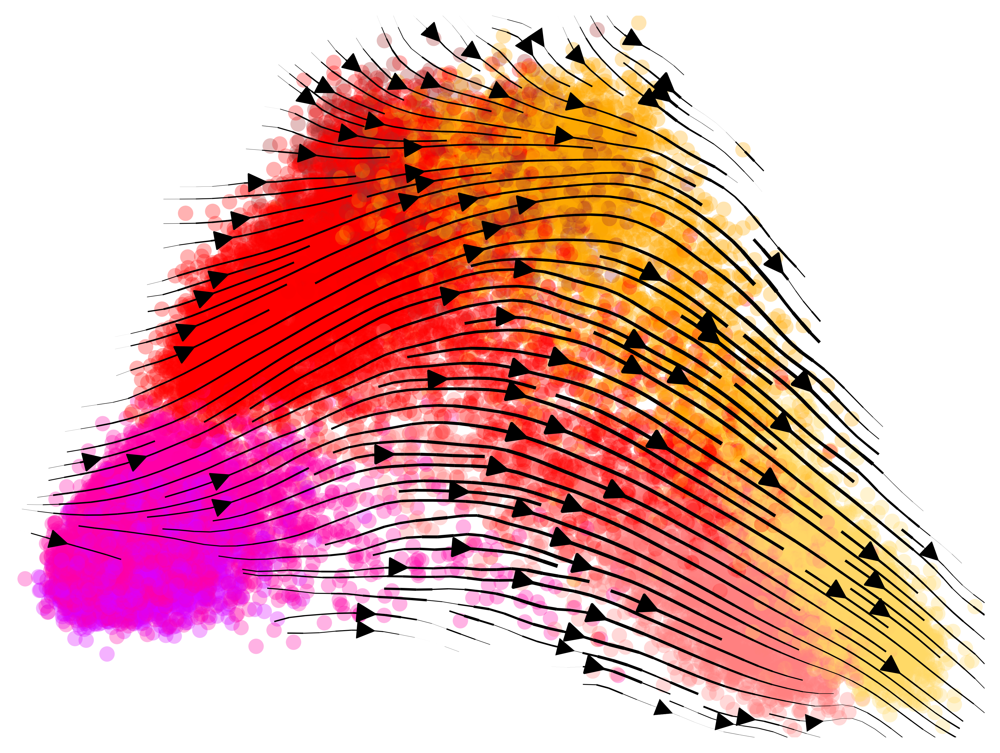

In [17]:
fig = plt.figure(figsize=(8,6), dpi=300)

ax = fig.subplots()

scv.pl.velocity_embedding_stream(
    sneural, 
    basis='scv', 
    title="",
    color='cell_annotation', 
    show=False,
    ax=ax,
    palette=colpal.celltype,
    arrow_size=2,
    legend_loc=False,
    size=200,
    fontsize=16, 
    legend_fontsize=16, components='1,2'
)
plt.savefig('../figures/2.1.3_neural_scvelo.png', transparent=True)
plt.show()

In [18]:
nt_types = ['MN', 'V3', 'p3','FP']

snmp = adataS[[ct not in nt_types for ct in adataS.obs.cell_annotation]]
snmp = snmp[[tp not in ['D3','D6','D7','D8'] for tp in snmp.obs.timepoint]]

snmp_genes = vt.pp.select_genes(
    snmp[snmp.obs.rep!='r4'], 
    n_variable_genes=2000, 
    stratify_obs='rep')

scv.pp.normalize_per_cell(snmp)
snmp = snmp[:,snmp_genes]

Normalized count data: X, spliced, unspliced.


In [19]:
scv.pp.moments(snmp, n_pcs=30, n_neighbors=30)
scv.tl.velocity(snmp)

computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [20]:
X = snmp.layers['spliced'].A
V = snmp.layers['velocity']

V = np.nan_to_num(V)
Y = np.clip(X + V, 0, 1000)

Xlog = np.log1p(X)
Xlogscale = Xlog - Xlog.mean(0)
pca = PCA()
Xpca = pca.fit_transform(Xlogscale)
snmp.obsm['X_scv'] = Xpca

Ylogscale = np.log1p(Y) - Xlog.mean(0)
Ypca = pca.transform(Ylogscale)

snmp.obsm['velocity_scv'] = Ypca - Xpca
snmp.uns["velocity_params"] = {'embeddings':'scv'}

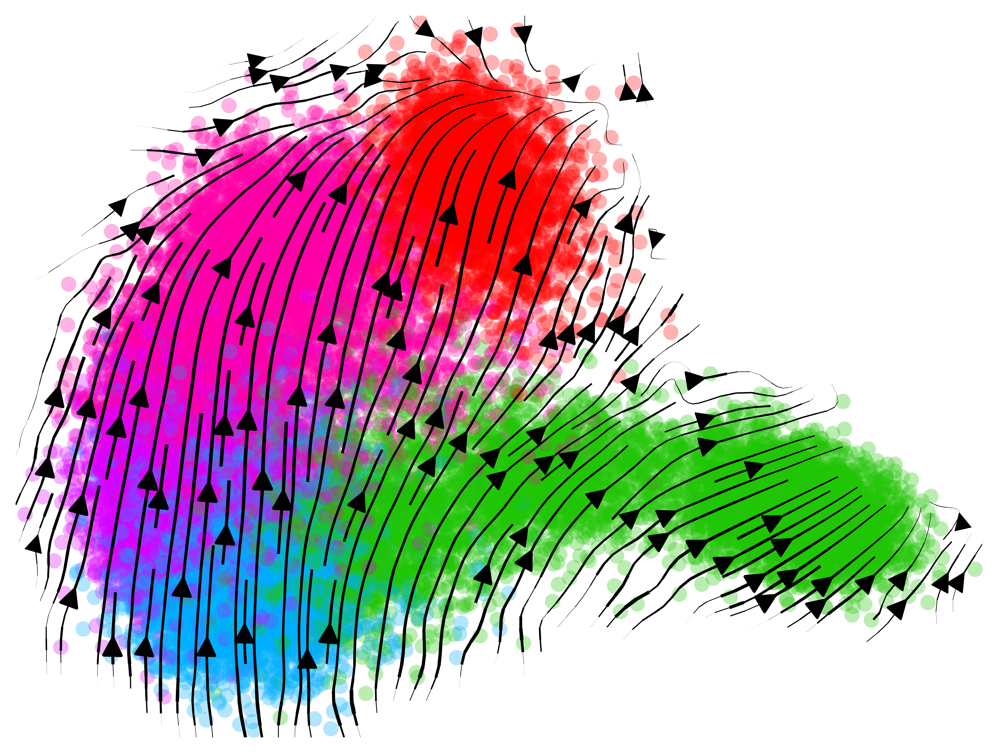

In [21]:
fig = plt.figure(figsize=(8,6), dpi=300)

ax = fig.subplots()

scv.pl.velocity_embedding_stream(
    snmp, 
    basis='scv', 
    title="",
    color='cell_annotation', 
    show=False,
    ax=ax,
    palette=colpal.celltype,
    arrow_size=2,
    legend_loc=False,
    size=200,
    fontsize=16, 
    legend_fontsize=16, components='1,2'
)
plt.savefig('../figures/2.1.4_nmp_scvelo.png', transparent=True)
plt.show()